In [51]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

import os
import numpy as np
import pandas as pd
import anndata as ad 
import squidpy as sq
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sb
import scvi 
import torch #pytorch
import runpy
import pickle
from datetime import datetime
import celltypist
from celltypist import models
import re

from os import sys
sys.path.append('/tmp/work/Visium/BRCA_2024/brca_scripts')
from visiumPipeline import processVisium
from applyCosineScores import cosineScores
from tumorSegmentation import retrieveTumorMask
from getRSigs import getRSigs
from py_AUCell import AUCell

sc.set_figure_params(figsize=(4,4))
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

In [30]:
samples = ['2018838/PRE-01','2018838/PRE-02','2018838/POST-03','2018838/POST-05',
           '2018839/PRE-04','2018839/PRE-05','2018839/POST-06','2018839/POST-11']

sample_names = [os.path.basename(sample) for sample in samples]

In [157]:
with open('visium_samples.pkl', 'rb') as file:
    visium_samples = pickle.load(file)

for_concat = dict(zip(samples, visium_samples.values()))
adatas = ad.concat(for_concat, label="dataset_name",  join="outer")

pre_names = ['2018838/PRE-01','2018838/PRE-02', '2018839/PRE-04','2018839/PRE-05']
post_names = ['2018838/POST-03','2018838/POST-05', '2018839/POST-06','2018839/POST-11']

## Correlation between cell type annotation and gene signatures

In [309]:
[gene_names, sigs] = getRSigs()

querying 1-11...
done.
Finished.
querying 1-7...
done.
Finished.
querying 1-4...
done.
Finished.
querying 1-3...
done.
Finished.
querying 1-12...
done.
Finished.
1 input query terms found dup hits:	[('ENSG00000072694', 2)]
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
querying 1-3...
done.
Finished.
querying 1-4...
done.
Finished.
1 input query terms found dup hits:	[('ENSG00000165025', 2)]
1 input query terms found no hit:	['None']
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
querying 1-16...
done.
Finished.
querying 1-16...
done.
Finished.
querying 1-7...
done.
Finished.
querying 1-10...
done.
Finished.
querying 1-5...
done.
Finished.
querying 1-7...
done.
Finished.
querying 1-10...
done.
Finished.
1 input query terms found no hit:	['ENSG00000112096']
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
querying 1-12...
done.
Finished.
1 input query terms found no hit:	['ENSG00

In [325]:
def gene_sig_cos_sim_heatmap(input_names,order = None):
    mask = adatas.obs['dataset_name'].isin(input_names)
    subset_adata = adatas[mask]
    
    sigs_of_interrest_list = ['Goff_B cells', 'Goff_NK cells', 'Yang_Bcells', 'DN2_Bcells', 'Zhang_hM10_Macro-IL1B', 'Zhang_hM08_Macro-NLRP3']

    sigs_of_interrest_list = sigs
    
    meta_columns = subset_adata.obs.columns.tolist()
    cos_sim_re = [(i, text, re.search('cos_sim', text)) for i, text in enumerate(meta_columns) if re.search('cos_sim', text)]
    
    cos_sim_of_interest_list = [sublist[1] for sublist in cos_sim_re]
    
    # Extract columns from adatas.obs for both lists
    cos_sim_columns = pd.DataFrame({col: subset_adata.obs[col] for col in cos_sim_of_interest_list})
    gene_sig_columns = pd.DataFrame({col: subset_adata.obs[col] for col in sigs_of_interrest_list})
    
    # 1. Ensure both DataFrames have the same number of rows
    if len(cos_sim_columns) != len(gene_sig_columns):
        raise ValueError("The two DataFrames must have the same number of rows.")
    
    # You can either drop rows with NaN values or fill them with a default value (e.g., 0)
    cos_sim_columns.fillna(0, inplace=True)
    gene_sig_columns.fillna(0, inplace=True)
    
    # 3. Ensure the data types are numeric
    cos_sim_columns = cos_sim_columns.apply(pd.to_numeric, errors='coerce')
    gene_sig_columns = gene_sig_columns.apply(pd.to_numeric, errors='coerce')
    
    # Perform correlation between the two DataFrames
    correlation_result = cos_sim_columns.corrwith(gene_sig_columns)
    
    combined_df = pd.concat([cos_sim_columns, gene_sig_columns], axis=1)
    combined_df
    
    df1 = cos_sim_columns
    df2 = gene_sig_columns
    
    correlation_results = pd.DataFrame(index=df1.columns, columns=df2.columns)
    
    # Compute pairwise correlations
    for col1 in df1.columns:
        for col2 in df2.columns:
            correlation_results.loc[col1, col2] = df1[col1].corr(df2[col2])
    
    # Convert to numeric (in case of any non-numeric entries)
    correlation_results = correlation_results.apply(pd.to_numeric)

    if order is None:
        ax = sb.clustermap(correlation_results, annot=None, cmap='coolwarm', center=0, 
                         linewidths=0, rasterized=True, vmin=-.3, vmax=0.6)
        
        ax.ax_row_dendrogram.set_visible(False) #suppress row dendrogram
        ax.ax_col_dendrogram.set_visible(False) #suppress column dendrogram
        ax.ax_heatmap.grid(False)  # Remove grid lines inside the heatmap
        
        # Show the plot
        # plt.show()
        return [ax.dendrogram_row.reordered_ind, ax.dendrogram_col.reordered_ind]

    else:
        correlation_results = correlation_results.iloc[order[0],order[1]]
        
        # Plot heatmap
        plt.figure(figsize=(10, 8))
        ax = sb.heatmap(correlation_results, annot=None, cmap='coolwarm', center=0, 
                         linewidths=0, rasterized=True, vmin=-.3, vmax=0.6)

        ax.grid(False)  # Remove grid lines inside the heatmap

        plt.title('Cell type cos sim vs Gene signature pairwise correlation')
        # plt.show()
        return plt


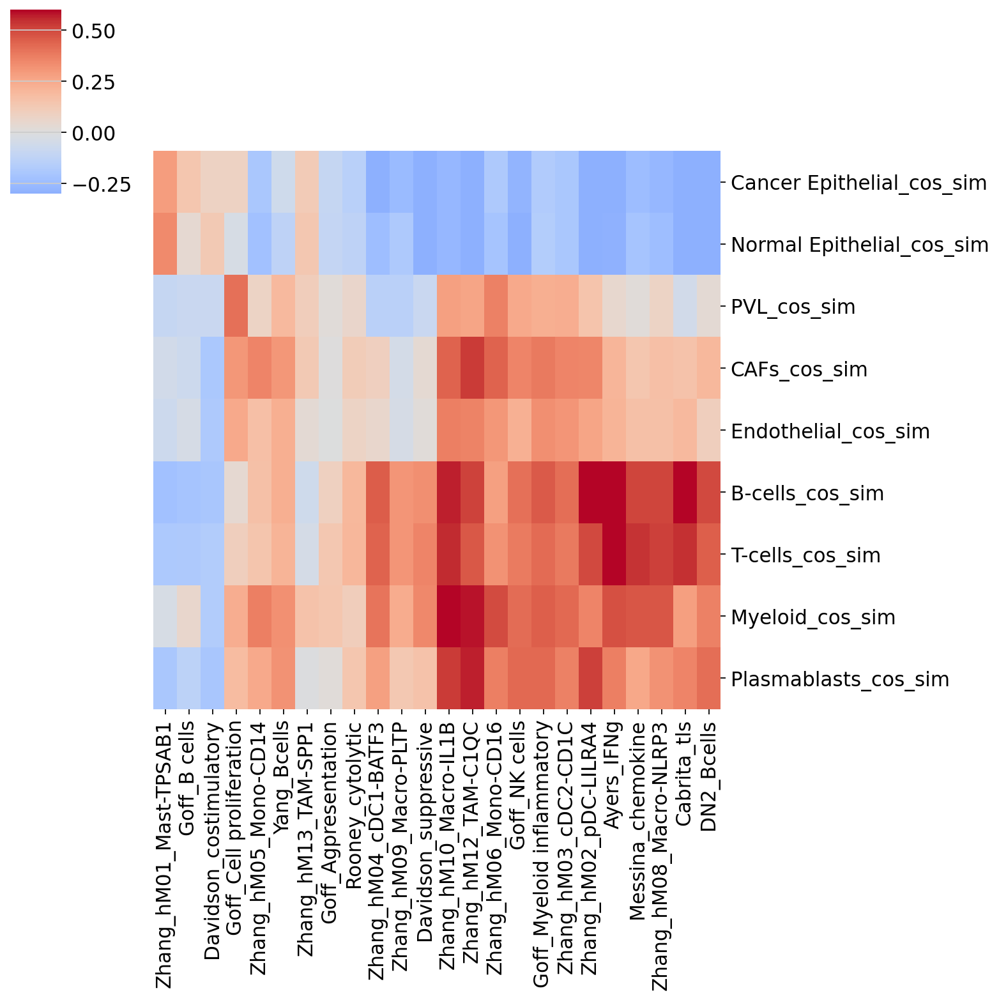

In [326]:
new_order = gene_sig_cos_sim_heatmap(pre_names)

<module 'matplotlib.pyplot' from '/opt/conda/lib/python3.10/site-packages/matplotlib/pyplot.py'>

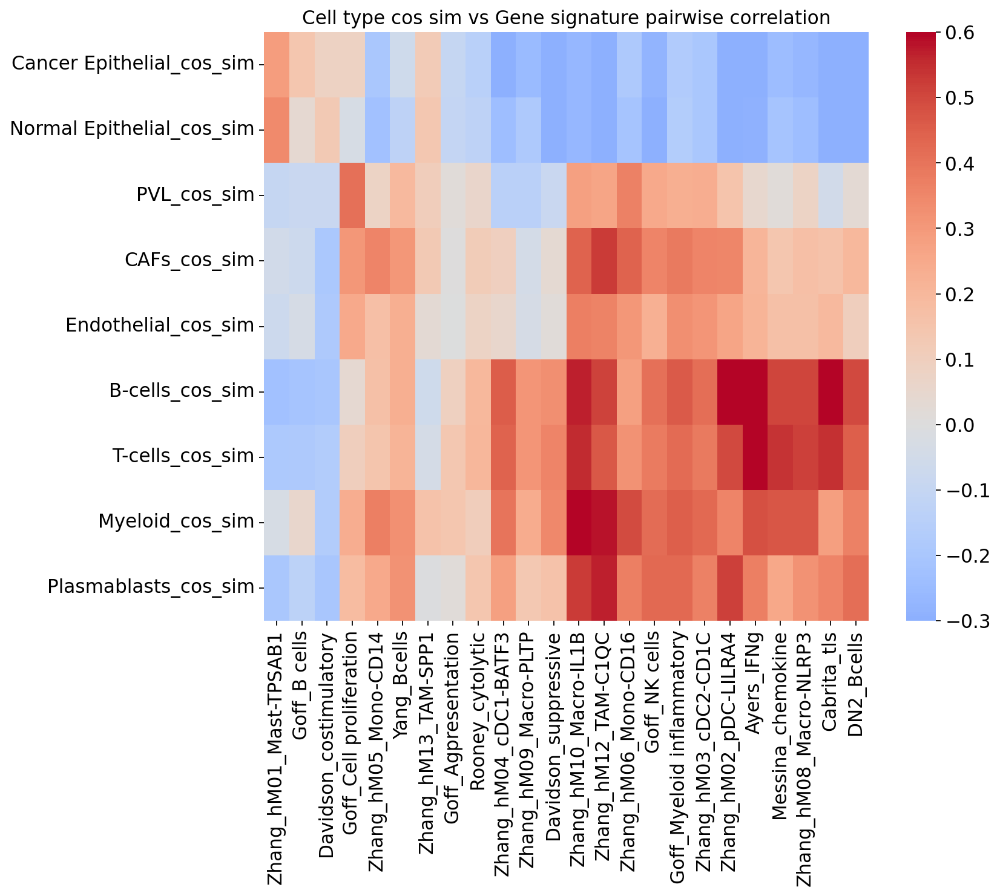

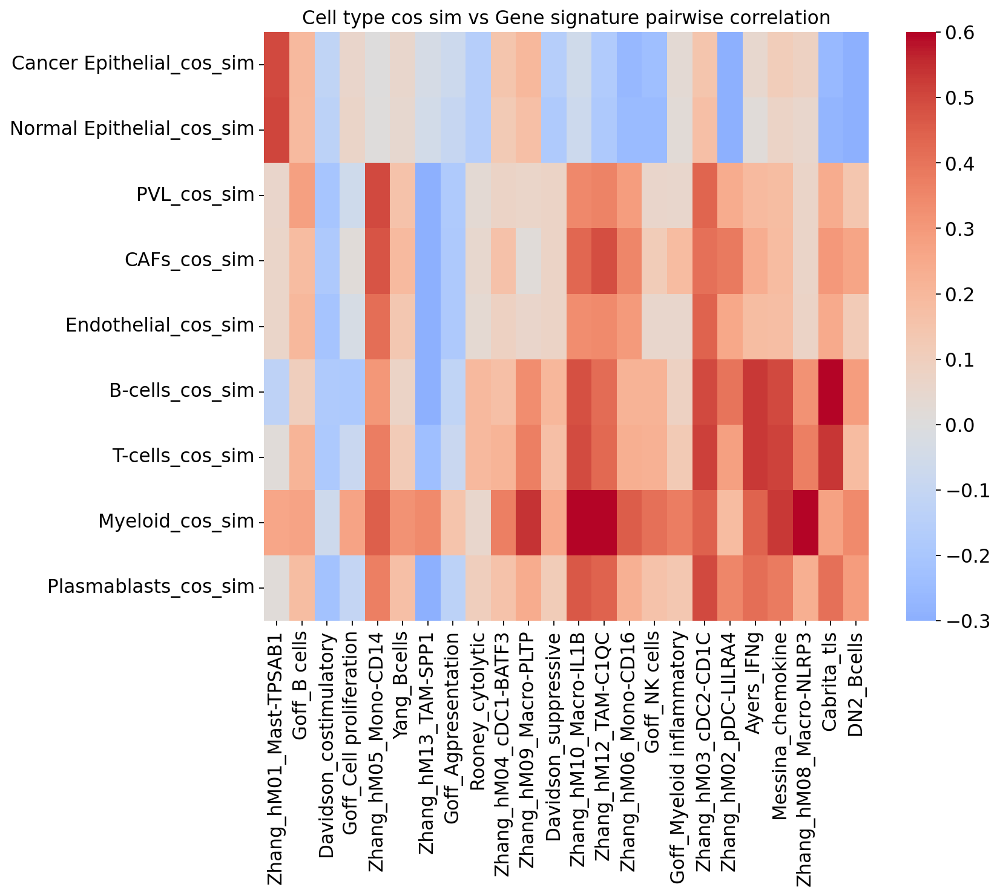

In [327]:
gene_sig_cos_sim_heatmap(pre_names,new_order)
gene_sig_cos_sim_heatmap(post_names,new_order)

## Neighborhood analysis

{'B cells',
 'Early MK',
 'Endothelial cells',
 'Epithelial cells',
 'Fibroblasts',
 'Macrophages',
 'Plasma cells',
 'pDC'}

Creating graph using `generic` coordinates and `None` transform and `1` libraries.
Adding `adata.obsp['spatial_connectivities']`
       `adata.obsp['spatial_distances']`
       `adata.uns['spatial_neighbors']`
Finish (0:00:00)
Calculating neighborhood enrichment using `1` core(s)


100%|██████████| 1000/1000 [00:00<00:00, 1172.83/s]


Adding `adata.uns['majority_voting_nhood_enrichment']`
Finish (0:00:00)


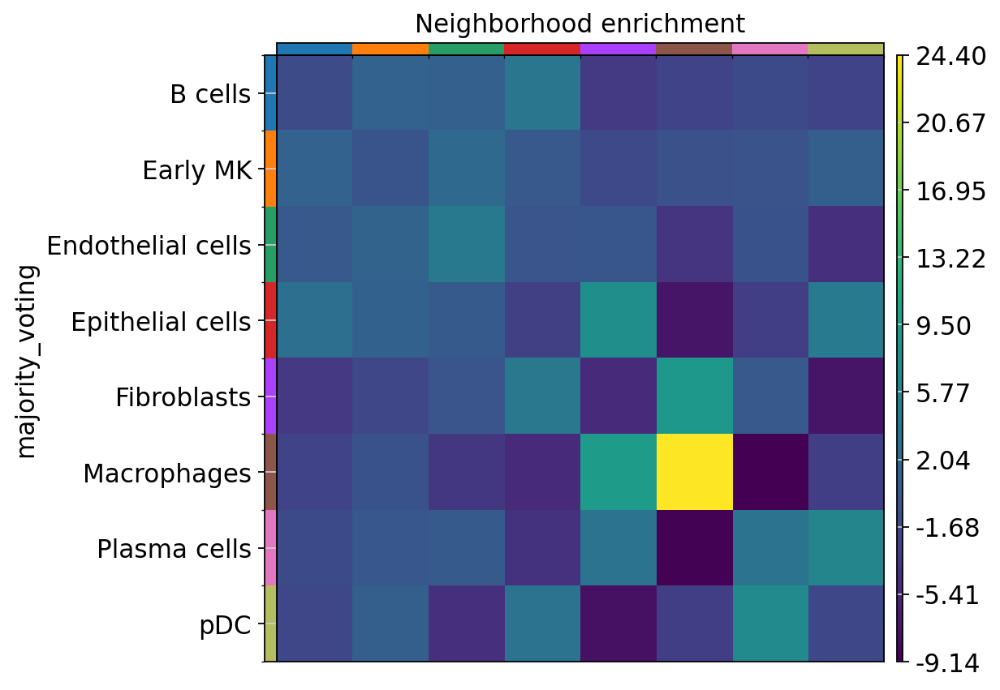

In [377]:
sq.gr.spatial_neighbors(adatas)
sq.gr.nhood_enrichment(adatas, cluster_key="majority_voting")
sq.pl.nhood_enrichment(adatas, cluster_key="majority_voting")

In [397]:
subset_adata.obs['dataset_name']

AACACTTGGCAAGGAA-1    2018838/POST-03
AACAGGATTCATAGTT-1    2018838/POST-03
AACAGGTTATTGCACC-1    2018838/POST-03
AACAGGTTCACCGAAG-1    2018838/POST-03
AACATAGTCTATCTAC-1    2018838/POST-03
                           ...       
TGTTGCGTCCAAGATT-1    2018838/POST-05
TGTTGGAACCTTCCGC-1    2018838/POST-05
TGTTGGAACGAGGTCA-1    2018838/POST-05
TGTTGGATGGACTTCT-1    2018838/POST-05
TGTTGGCCAGACCTAC-1    2018838/POST-05
Name: dataset_name, Length: 5464, dtype: category
Categories (2, object): ['2018838/POST-03', '2018838/POST-05']

Creating graph using `generic` coordinates and `None` transform and `1` libraries.
Adding `adata.obsp['spatial_connectivities']`
       `adata.obsp['spatial_distances']`
       `adata.uns['spatial_neighbors']`
Finish (0:00:00)
Calculating neighborhood enrichment using `1` core(s)


100%|██████████| 1000/1000 [00:00<00:00, 1835.11/s]


Adding `adata.uns['majority_voting_nhood_enrichment']`
Finish (0:00:00)
{'Fibroblasts', 'pDC', 'Endothelial cells', 'Epithelial cells', 'Macrophages', 'Plasma cells', 'Early MK', 'B cells'}
Creating graph using `generic` coordinates and `None` transform and `1` libraries.
Adding `adata.obsp['spatial_connectivities']`
       `adata.obsp['spatial_distances']`
       `adata.uns['spatial_neighbors']`
Finish (0:00:00)
Calculating neighborhood enrichment using `1` core(s)


100%|██████████| 1000/1000 [00:00<00:00, 2120.77/s]


Adding `adata.uns['majority_voting_nhood_enrichment']`
Finish (0:00:00)
{'Fibroblasts', 'pDC', 'Endothelial cells', 'Epithelial cells', 'Macrophages', 'Plasma cells', 'Early MK', 'B cells'}


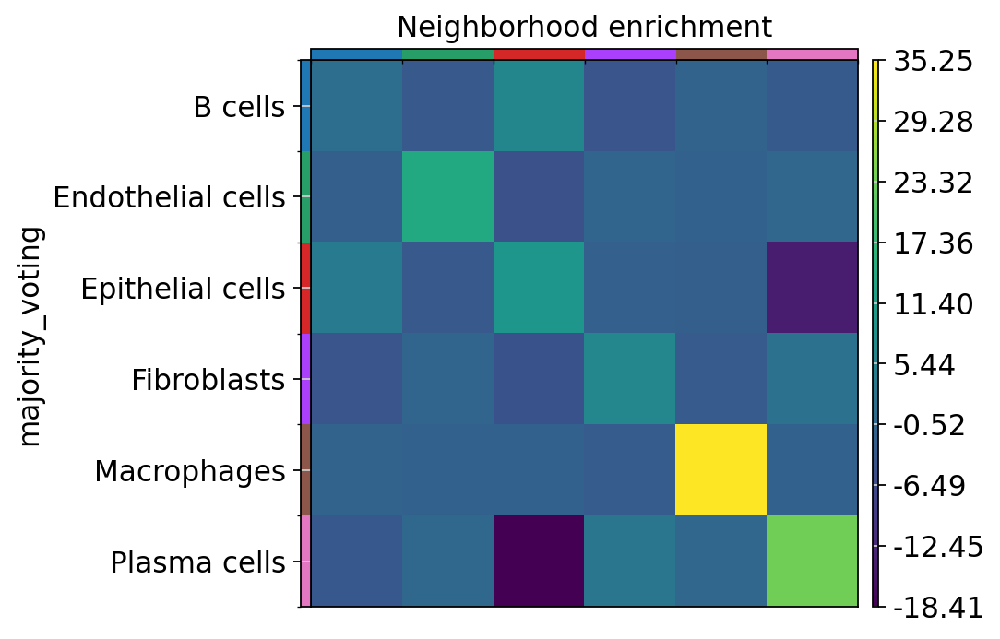

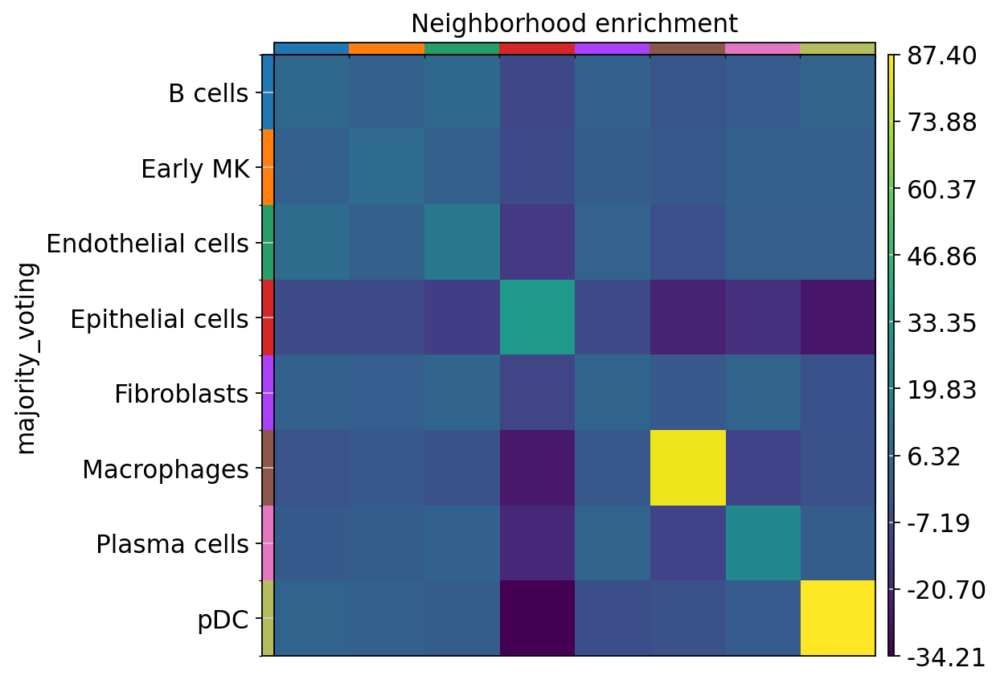

In [408]:
pre_names = ['2018838/PRE-01','2018838/PRE-02', '2018839/PRE-04','2018839/PRE-05']
post_names = ['2018838/POST-03','2018838/POST-05', '2018839/POST-06','2018839/POST-11']

#pre set
mask = adatas.obs['dataset_name'].isin(pre_names)
subset_adata = adatas[mask]
sq.gr.spatial_neighbors(subset_adata)
sq.gr.nhood_enrichment(subset_adata, cluster_key="majority_voting")
sq.pl.nhood_enrichment(subset_adata, cluster_key="majority_voting")

print(set(adatas.obs['majority_voting']))

#post set
mask = adatas.obs['dataset_name'].isin(post_names)
subset_adata = adatas[mask]
sq.gr.spatial_neighbors(subset_adata)
sq.gr.nhood_enrichment(subset_adata, cluster_key="majority_voting")
sq.pl.nhood_enrichment(subset_adata, cluster_key="majority_voting")

print(set(subset_adata.obs['majority_voting']))

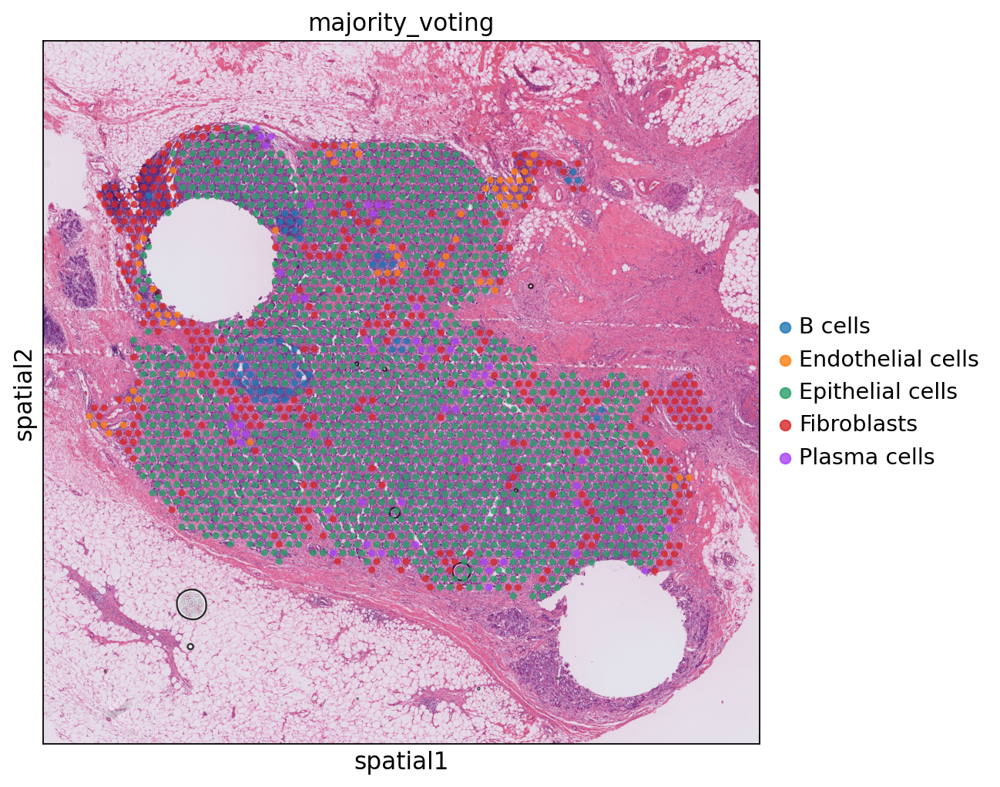

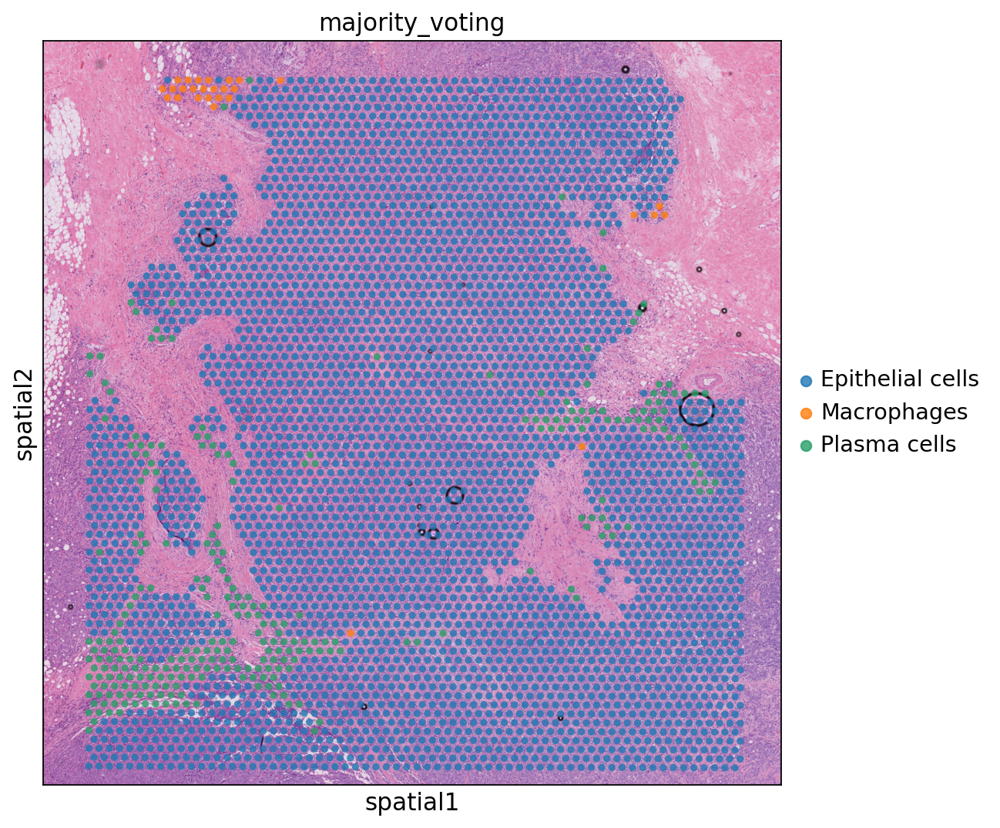

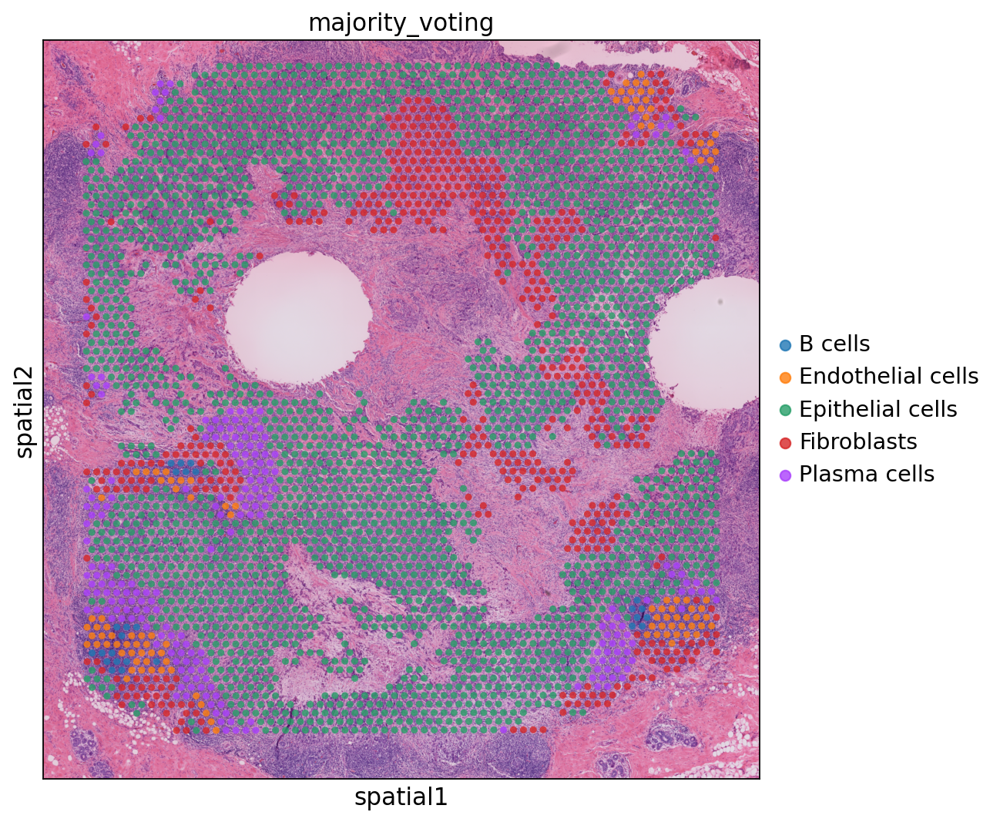

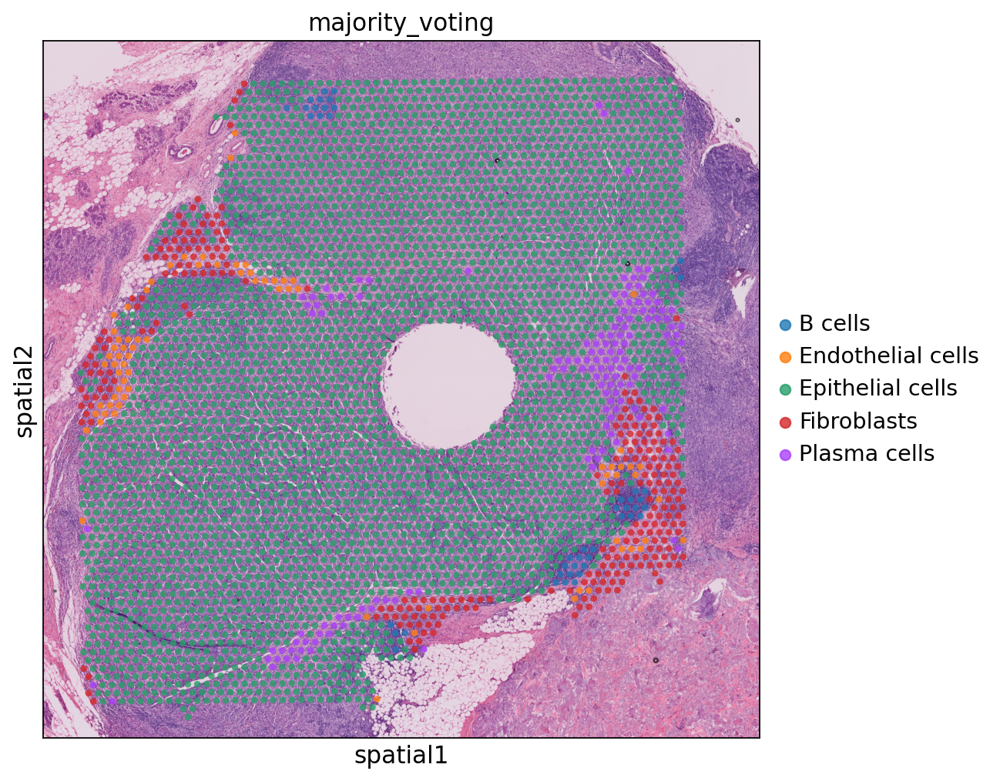

In [407]:
adata_test = visium_samples['PRE-01']
sq.pl.spatial_scatter(adata_test, color="majority_voting", alpha = 0.8)

adata_test = visium_samples['PRE-02']
sq.pl.spatial_scatter(adata_test, color="majority_voting", alpha = 0.8)

adata_test = visium_samples['PRE-04']
sq.pl.spatial_scatter(adata_test, color="majority_voting", alpha = 0.8)

adata_test = visium_samples['PRE-05']
sq.pl.spatial_scatter(adata_test, color="majority_voting", alpha = 0.8)

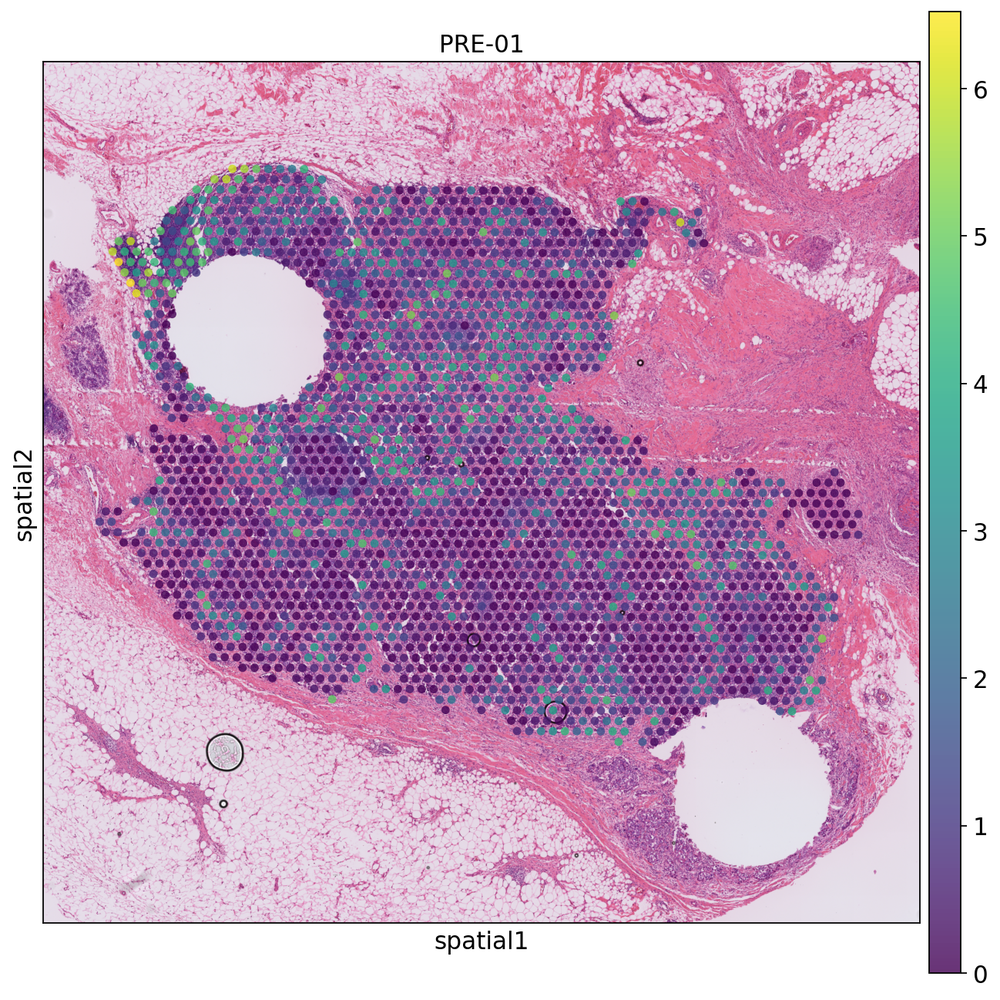

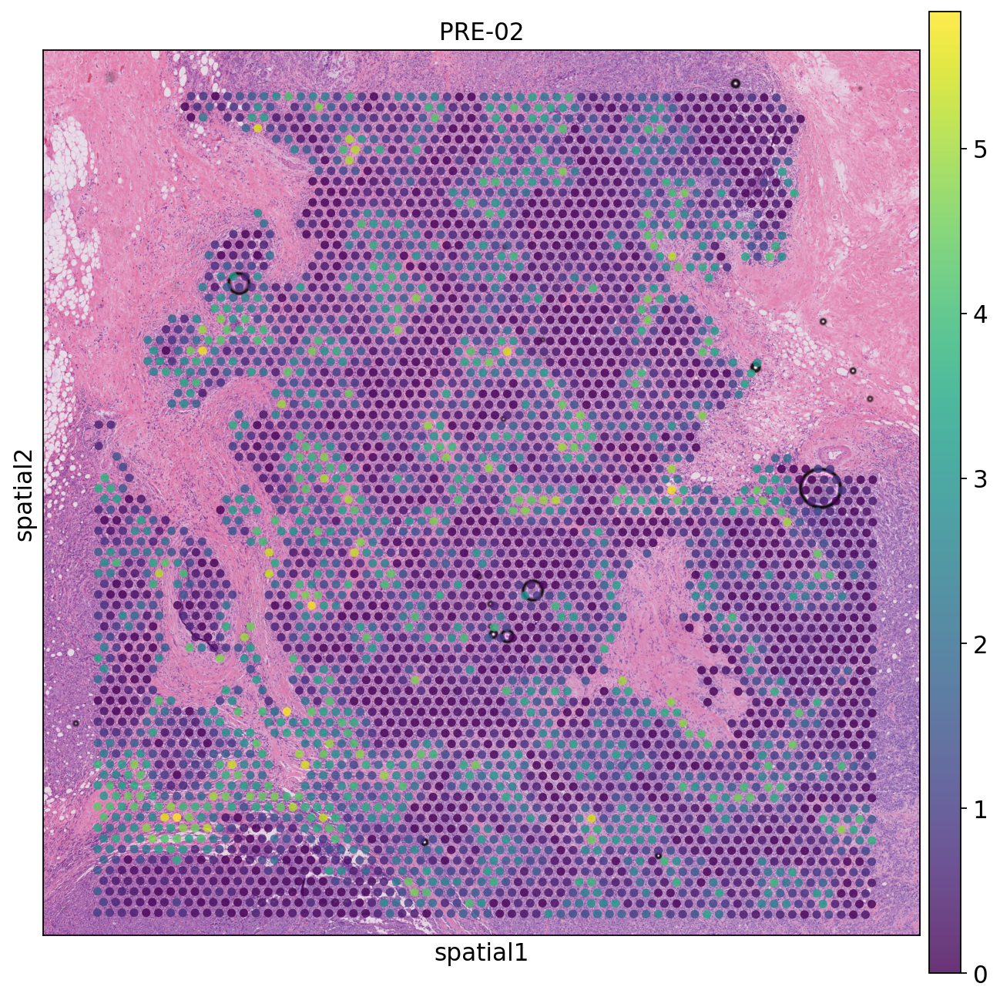

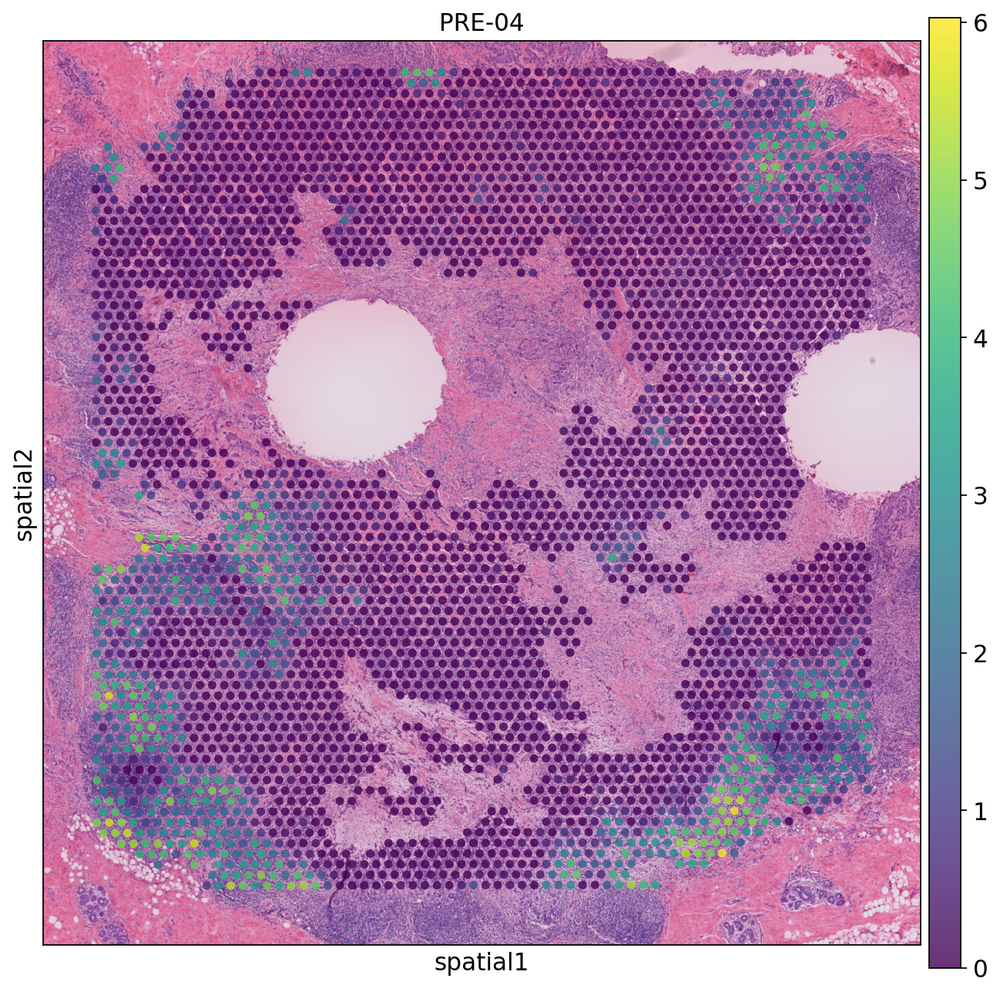

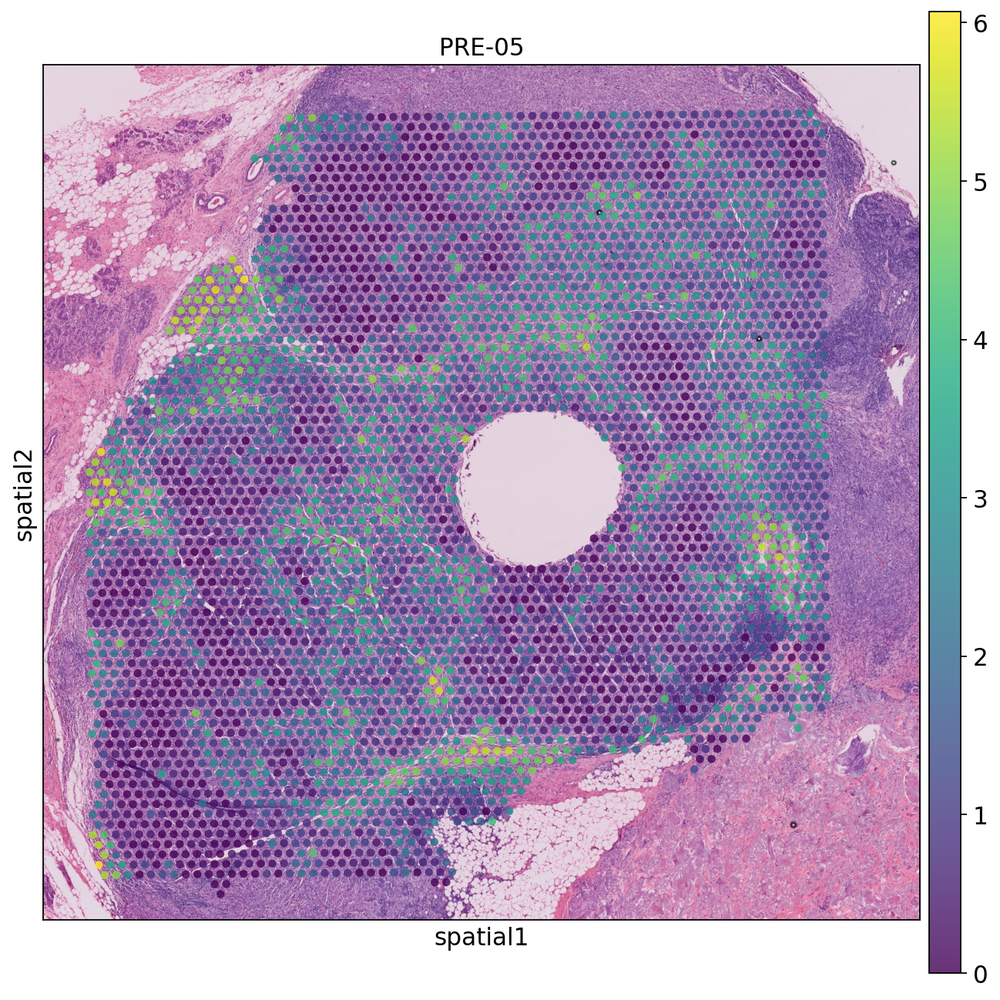

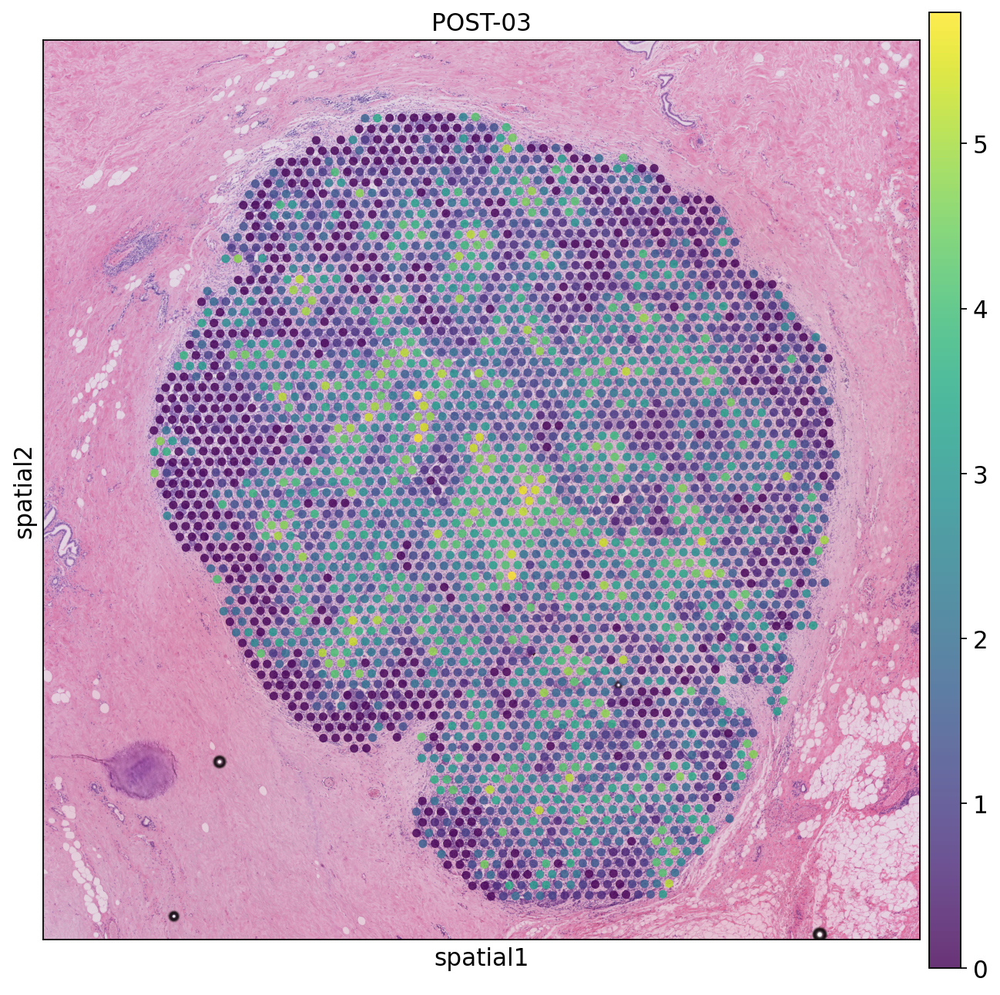

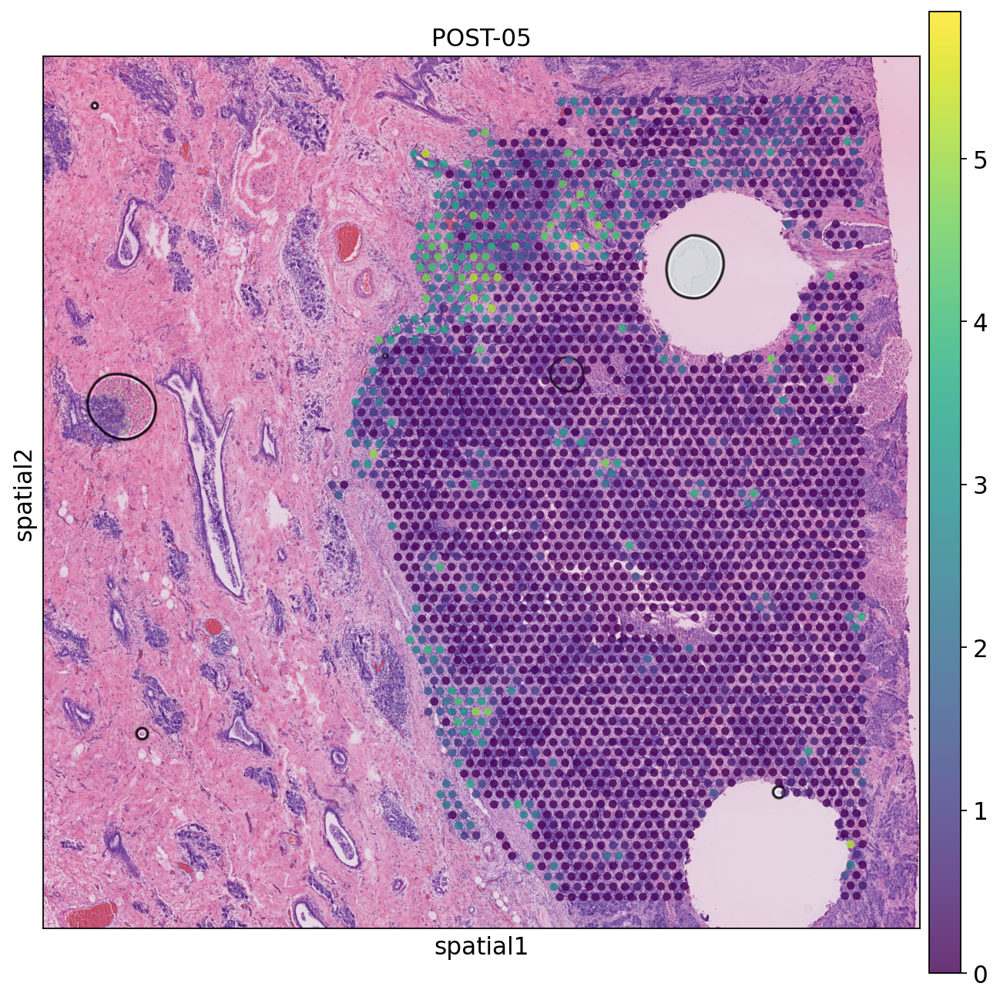

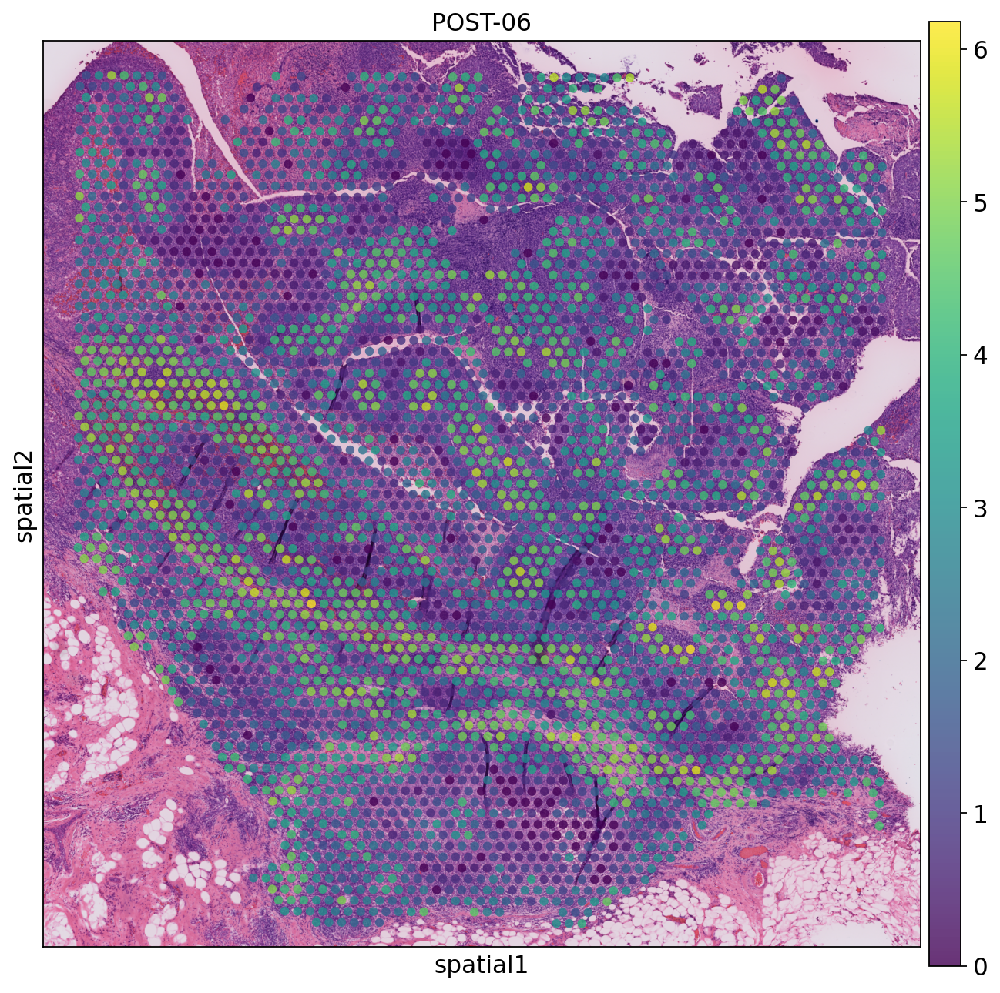

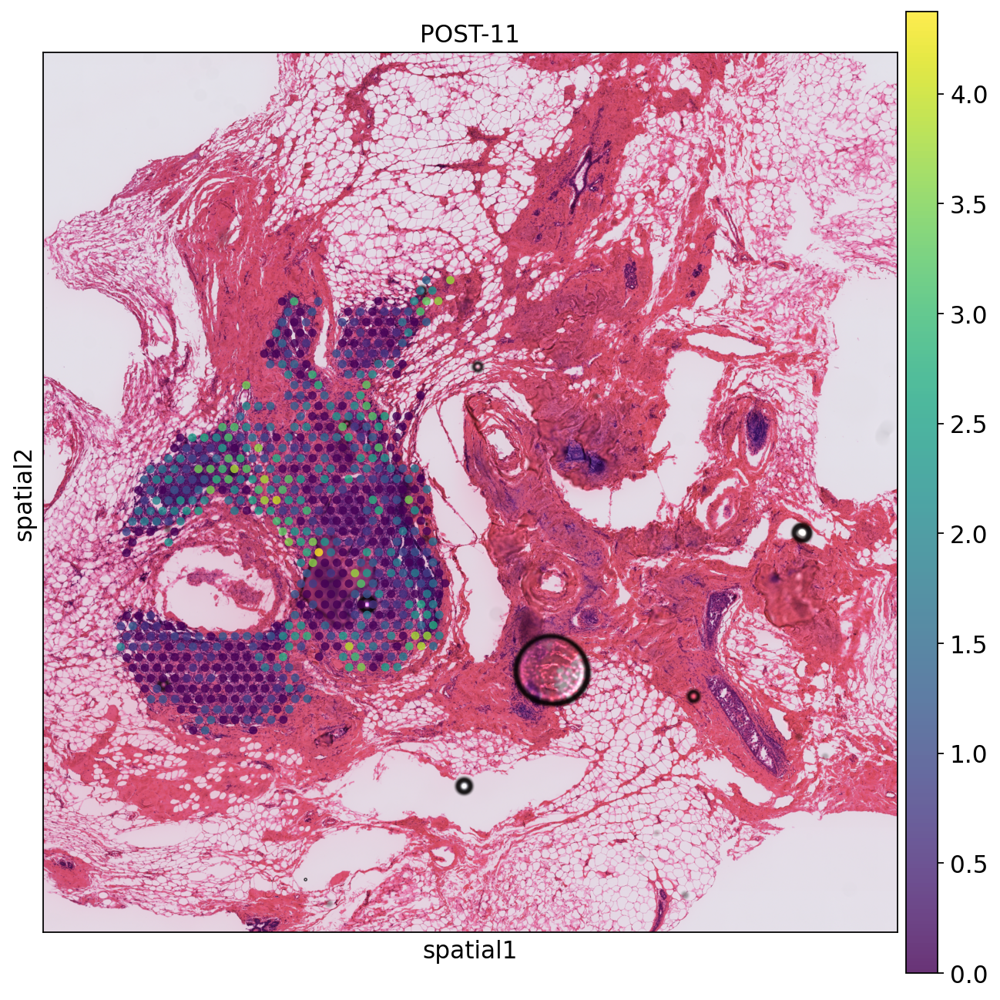

In [75]:
import warnings
warnings.filterwarnings("ignore")

sample_names = ['PRE-01', 'PRE-02', 'PRE-04', 'PRE-05', 'POST-03', 'POST-05','POST-06', 'POST-11']

for i in range(len(sample_names)):
    sq.pl.spatial_scatter(visium_samples[sample_names[i]], color="IGHA1", alpha = 0.8, title = sample_names[i])

In [23]:
with open('visium_samples.pkl', 'rb') as file:
    visium_samples = pickle.load(file)

In [28]:
visium_samples

{'PRE-01': AnnData object with n_obs × n_vars = 2159 × 18019
     obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'clusters', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'B-cells_cos_sim', 'CAFs_cos_sim', 'Cancer Epithelial_cos_sim', 'Endothelial_cos_sim', 'Myeloid_cos_sim', 'Normal Epithelial_cos_sim', 'PVL_cos_sim', 'Plasmablasts_cos_sim', 'T-cells_cos_sim', 'Messina_chemokine', 'Cabrita_tls', 'Goff_Cell proliferation', 'Goff_Myeloid inflammatory', 'Goff_Agpresentation', 'Goff_B cells', 'Goff_NK cells', 'Zhang_hM01_Mast-TPSAB1', 'Zhang_hM02_pDC-LILRA4', 'Zhang_hM03_cDC2-CD1C', 'Zhang_hM04_cDC1-BATF3', 'Zhang_hM05_Mono-CD14', 'Zhang_hM06_Mono-CD16', 'Zhang_hM08_Macro-NLRP3'